# Math 154: Group Data Project (This is ADS #2 that we examined)
## Give Me Some Credit Kaggle Competition
*Seena Huang, Cecelia Sanborn, Harry Bendekgey, Simon Posada Fishman*

[Link to Kaggle Kernel](https://www.kaggle.com/simonpfish/comp-stats-group-data-project-final)

In [1]:
# Main tools we used:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Models:
from sklearn import svm
from sklearn.model_selection import cross_validate
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestClassifier

# Python utilities:
import time
import os

(Below added by amc)

In [2]:
%matplotlib inline

# Data Exploration
First let's take a look at what our predictors are:

In [3]:
df = pd.read_csv('data/cs-training.csv')

list(df)

['Unnamed: 0',
 'SeriousDlqin2yrs',
 'RevolvingUtilizationOfUnsecuredLines',
 'age',
 'NumberOfTime30-59DaysPastDueNotWorse',
 'DebtRatio',
 'MonthlyIncome',
 'NumberOfOpenCreditLinesAndLoans',
 'NumberOfTimes90DaysLate',
 'NumberRealEstateLoansOrLines',
 'NumberOfTime60-89DaysPastDueNotWorse',
 'NumberOfDependents']

We also want to know how balanced the data set is, so we check what portion defaulted:

In [4]:
df.SeriousDlqin2yrs.mean()

0.06684

"If you're over 55 and need a mortgage, the important thing to know if that lenders can't deny you a loan based on your age. But age can factor into your mortgage equation." ([source](https://www.chicagotribune.com/news/ct-xpm-2005-11-20-0511200488-story.html))

This should be our first concern: making sure we're in legally okay territory. In order to solve this, we need to confirm that in our data set age has a negative influence on probability of defaulting. Then we can assume that the models we build reflect that trend, and won't deny someone a loan simply because they are old.
    

Text(0.5, 1.0, 'SeriousDlqin2yrs = 1')

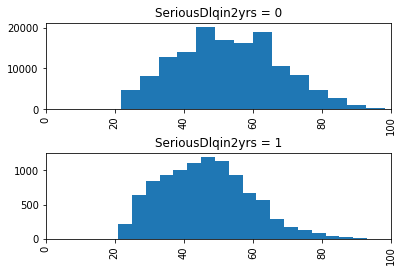

In [7]:
age_hist = df['age'].hist(by=df['SeriousDlqin2yrs'], bins=20, layout=(2,1))
age_hist[0].set_xlim((0,100))
age_hist[0].set_title('SeriousDlqin2yrs = 0')
age_hist[1].set_xlim((0,100))
age_hist[1].set_title('SeriousDlqin2yrs = 1')

Nice! Looking at the distribution of people that defaulted vs those who did not shows us that, generally, younger people were more responsible for defaulting. So we're good to go, legally.

Let's take a look at our data. We can start with Debt Ratio, the ratio of debt to assets.

In [8]:
df.DebtRatio.describe()

count    150000.000000
mean        353.005076
std        2037.818523
min           0.000000
25%           0.175074
50%           0.366508
75%           0.868254
max      329664.000000
Name: DebtRatio, dtype: float64

It is very concerning that someone owes 330,000 times what they own. Maybe that person is a single outlier? Let's take a look:

In [9]:
df.DebtRatio.quantile([.975])

0.975    3489.025
Name: DebtRatio, dtype: float64

Apparently 2.5% of the dataset owes more than 3,500 times what they own. We need to investigate further to see if these are outliers or not. We can see:

In [10]:
df[df['DebtRatio'] > 3489.025][['SeriousDlqin2yrs','MonthlyIncome']].describe()

,SeriousDlqin2yrs,MonthlyIncome
count,3750.000000,185.000000
mean,0.064267,0.064865
std,0.245260,0.246956
min,0.000000,0.000000
25%,0.000000,0.000000
50%,0.000000,0.000000
75%,0.000000,0.000000
max,1.000000,1.000000


We see two particularly concerning things here. The first is that of 4,000 records with DebtRatio > 3,500, only 185 of them have a value for monthly income. Further, the people who do have monthly income seem to either have a monthly income of either 1 or 0. We see that:

In [11]:
df[(df['DebtRatio'] > 3489.025) & (df['SeriousDlqin2yrs'] == df['MonthlyIncome'])].shape[0]

164

...of those 185 entries, 164 of them have the same value for 2 year default rate and monthly income, indicating that there is a data-entry error.

The second problem is that despite owing thousands of times what they own, these people aren't defaulting any more than the general population. We can conclude that these entries must be data-entry errors, so we will remove them from our model.

Now let's take a look at NumberOfTimes90DaysLate.

In [12]:
df.groupby('NumberOfTimes90DaysLate').NumberOfTimes90DaysLate.count()

NumberOfTimes90DaysLate
0     141662
1       5243
2       1555
3        667
4        291
5        131
6         80
7         38
8         21
9         19
10         8
11         5
12         2
13         4
14         2
15         2
17         1
96         5
98       264
Name: NumberOfTimes90DaysLate, dtype: int64

It is interesting that no one is between 17 and 96 times late, but hundreds of people are 98 times late. We can take a look at these few hundred records:

In [13]:
df[df['NumberOfTimes90DaysLate'] > 95][['SeriousDlqin2yrs','NumberOfTime60-89DaysPastDueNotWorse','NumberOfTime30-59DaysPastDueNotWorse','NumberOfTimes90DaysLate']].describe()

,SeriousDlqin2yrs,NumberOfTime60-89DaysPastDueNotWorse,NumberOfTime30-59DaysPastDueNotWorse,NumberOfTimes90DaysLate
count,269.000000,269.000000,269.000000,269.000000
mean,0.546468,97.962825,97.962825,97.962825
std,0.498764,0.270628,0.270628,0.270628
min,0.000000,96.000000,96.000000,96.000000
25%,0.000000,98.000000,98.000000,98.000000
50%,1.000000,98.000000,98.000000,98.000000
75%,1.000000,98.000000,98.000000,98.000000
max,1.000000,98.000000,98.000000,98.000000


Somehow, all these (300) people were 30-59 days late 96/98 times, 60-89 days late 96/98 times, and 90+ days late 96/98 times. This is really concerning. However, the data might not be garbage, because (as expected) these people are defaulting at a massive rate (55%) compared to the population (6%). So we don't want to throw away this data. We can Winsorize by replacing all the 96/98s with 20s to make them not extreme outliers and see if that improves the models. We don't expect that to improve the random forests, which are robust to outliers, but it might improve the SVMs.

Finally, let's take a look at revolving utilization of unsecured lines. It represents the ratio of money owed to credit limit, so it shouldn't get much above 1. First let's look at values close to 1 and see at what rate they're defaulting. We start with 0.9 to 4.0:

In [14]:
df[(df['RevolvingUtilizationOfUnsecuredLines'] > .9) & (df['RevolvingUtilizationOfUnsecuredLines'] <= 4)].SeriousDlqin2yrs.describe()

count    19805.000000
mean         0.225347
std          0.417821
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
Name: SeriousDlqin2yrs, dtype: float64

These 20,000 people are defaulting at a rate of almost 1-in-4. This is important! But what about people with more RUUL? Let's consider 4 to 10:

In [15]:
df[(df['RevolvingUtilizationOfUnsecuredLines'] > 4) & (df['RevolvingUtilizationOfUnsecuredLines'] <= 10)].SeriousDlqin2yrs.describe()


count    23.000000
mean      0.260870
std       0.448978
min       0.000000
25%       0.000000
50%       0.000000
75%       0.500000
max       1.000000
Name: SeriousDlqin2yrs, dtype: float64

There are only 23 records in this region, but they're still defaulting at a high rate. What about if we go even higher, and consider those with RUUL > 10?

In [16]:
df[df['RevolvingUtilizationOfUnsecuredLines'] > 10].describe()

,Unnamed: 0,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,241.000000,241.000000,241.000000,241.000000,241.000000,241.000000,173.00000,241.000000,241.000000,241.000000,241.000000,228.000000
mean,77655.004149,0.070539,3564.023932,50.630705,0.186722,571.918644,8467.67052,5.763485,0.074689,1.186722,0.087137,0.688596
std,41010.846073,0.256587,5123.802683,14.565389,0.579502,1772.948412,6564.06825,3.114160,0.579711,1.065750,0.559651,1.038659
min,294.000000,0.000000,11.385230,24.000000,0.000000,0.000800,0.00000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,44564.000000,0.000000,941.000000,39.000000,0.000000,0.217813,4500.00000,4.000000,0.000000,0.000000,0.000000,0.000000
50%,80200.000000,0.000000,2012.000000,48.000000,0.000000,0.402560,7000.00000,5.000000,0.000000,1.000000,0.000000,0.000000
75%,111663.000000,0.000000,4116.000000,62.000000,0.000000,59.000000,10091.00000,7.000000,0.000000,2.000000,0.000000,1.000000
max,149280.000000,1.000000,50708.000000,87.000000,3.000000,21395.000000,44472.00000,21.000000,8.000000,9.000000,7.000000,4.000000


These 241 people are not defaulting any more than anyone else, despite some of them owing hundreds of thousands of times their credit limits. These seem to be inconsistent with the rest of the data, so we can remove them from our model.

Finally, let's take a look at using regression to fill in the missing values for MonthlyIncome:

In [17]:
not_missing = df.dropna()
target = 'MonthlyIncome'
predictors = [c for c in list(not_missing) if c not in [target, 'Unnamed: 0','SeriousDlqin2yrs']]
X_data = not_missing[predictors]
y_data = not_missing[target]
regr = LinearRegression().fit(X_data, y_data)

In [18]:
regr.score(X_data, y_data)

0.02201505632577072

This is a terrible  R^2 . It seems that our best bet is to just replace the missing values with the median (instead of the mean, because there are some extreme outliers in MonthlyIncome, who are making millions of dollars a month). The other column with missing values is NumberOfDependents. >50% of the non-missing values have 0 dependents, and if someone leaves the field blank it is likely to be due to not having any dependents, we'll replace these values with 0.

## Datasets

Based on all of these insights, we built some datasets that will potentially improve our model performance:

In [5]:
# Median Fill, Outliers Removed
removed_debt_outliers = df.drop(df[df['DebtRatio'] > 3489.025].index)
removed_debt_outliers = removed_debt_outliers.fillna(removed_debt_outliers.median())

In [6]:
# Removed utilization outliers
dfus = removed_debt_outliers.drop(removed_debt_outliers[removed_debt_outliers['RevolvingUtilizationOfUnsecuredLines'] > 10].index)

In [7]:
# Removed 98s
dfn98 = dfus.copy()
dfn98.loc[dfn98['NumberOfTime30-59DaysPastDueNotWorse'] > 90, 'NumberOfTime30-59DaysPastDueNotWorse'] = 18
dfn98.loc[dfn98['NumberOfTime60-89DaysPastDueNotWorse'] > 90, 'NumberOfTime60-89DaysPastDueNotWorse'] = 18
dfn98.loc[dfn98['NumberOfTimes90DaysLate'] > 90, 'NumberOfTimes90DaysLate'] = 18

We will revisit these in the next section.

# Model Testing
To be able to rapidly test our models and datasets and see how they compare against each other, we developed a tester program that automatically runs k-fold cross-validation on scikit models accross different datasets.

In [22]:
# A utility class to test all of our models on different datasets
class Tester():
    def __init__(self, target):
        self.target = target
        self.datasets = {}
        self.models = {}
        self.cache = {} # we added a simple cache to speed things up

    def addDataset(self, name, df):
        self.datasets[name] = df.copy()

    def addModel(self, name, model):
        self.models[name] = model
        
    def clearModels(self):
        self.models = {}

    def clearCache(self):
        self.cache = {}
    
    def testModelWithDataset(self, m_name, df_name, sample_len, cv):
        if (m_name, df_name, sample_len, cv) in self.cache:
            return self.cache[(m_name, df_name, sample_len, cv)]

        clf = self.models[m_name]
        
        if not sample_len: 
            sample = self.datasets[df_name]
        else: sample = self.datasets[df_name].sample(sample_len)
            
        X = sample.drop([self.target], axis=1)
        Y = sample[self.target]

        s = cross_validate(clf, X, Y, scoring=['roc_auc'], cv=cv, n_jobs=-1)
        self.cache[(m_name, df_name, sample_len, cv)] = s

        return s

    def runTests(self, sample_len=80000, cv=4):
        # Tests the added models on all the added datasets
        scores = {}
        for m_name in self.models:
            for df_name in self.datasets:
                # print('Testing %s' % str((m_name, df_name)), end='')
                start = time.time()

                score = self.testModelWithDataset(m_name, df_name, sample_len, cv)
                scores[(m_name, df_name)] = score
                
                end = time.time()
                
                # print(' -- %0.2fs ' % (end - start))

        print('--- Top 10 Results ---')
        for score in sorted(scores.items(), key=lambda x: -1 * x[1]['test_roc_auc'].mean())[:10]:
            auc = score[1]['test_roc_auc']
            print("%s --> AUC: %0.4f (+/- %0.4f)" % (str(score[0]), auc.mean(), auc.std()))

            
# We will use a tester object across all models
tester = Tester('SeriousDlqin2yrs')

# You can add datasets like this:
tester.addDataset('Drop Missing', df.dropna())

# And models like this:
rfc = RandomForestClassifier(n_estimators=15, max_depth = 6, random_state=0)
tester.addModel('Simple Random Forest', rfc)
tester.addModel('Simple SVM', svm.LinearSVC())

# You can then use it to run the tests
tester.runTests()

--- Top 10 Results ---
('Simple Random Forest', 'Drop Missing') --> AUC: 0.8500 (+/- 0.0045)
('Simple SVM', 'Drop Missing') --> AUC: 0.6154 (+/- 0.0378)


Now that we have this tester up and running, let's go back to the datasets we created in our data exploration section. We can easily add them to the tester program to see how our models perform on them.

In [23]:
tester.addDataset('Median Fill', df.fillna(df.median()))
tester.addDataset('Median Fill, Outliers Removed', removed_debt_outliers)
tester.addDataset('Removed 98s', dfn98)
tester.addDataset('Removed utilization outliers', dfus)

tester.runTests()

--- Top 10 Results ---
('Simple Random Forest', 'Removed 98s') --> AUC: 0.8620 (+/- 0.0041)
('Simple Random Forest', 'Median Fill, Outliers Removed') --> AUC: 0.8607 (+/- 0.0040)
('Simple Random Forest', 'Removed utilization outliers') --> AUC: 0.8589 (+/- 0.0034)
('Simple Random Forest', 'Median Fill') --> AUC: 0.8583 (+/- 0.0069)
('Simple Random Forest', 'Drop Missing') --> AUC: 0.8500 (+/- 0.0045)
('Simple SVM', 'Drop Missing') --> AUC: 0.6154 (+/- 0.0378)
('Simple SVM', 'Removed 98s') --> AUC: 0.6142 (+/- 0.0154)
('Simple SVM', 'Removed utilization outliers') --> AUC: 0.6062 (+/- 0.0451)
('Simple SVM', 'Median Fill, Outliers Removed') --> AUC: 0.5833 (+/- 0.0479)
('Simple SVM', 'Median Fill') --> AUC: 0.5485 (+/- 0.0404)


We noticed that the modified datasets have a big influence on the SVM AUC scores, but they don't affect the Random Forests as much. However, there's a noticeable gain in performance between simply dropping the missing values and the modified datasets accross all models.

## Random Forests
Random Forests seemed to be the best bet, so we decided to move forward with them and figure out the best tuning parameters. Running two for-loops allowed us to find the best value for max_depth and number of estimators, with our best model being the random forest with a depth of 9 and 16 estimators. When we use the data set that removes the RUUL outliers, it gives us an AUC of .8662.

In [24]:
from sklearn.ensemble import RandomForestClassifier

for i in range(5,10):
    for j in range(10,20):
        rfc = RandomForestClassifier(n_estimators=j,max_depth = i, random_state=0)
        tester.addModel('Random Forest '+'d: '+str(i)+' est: '+str(j)  ,rfc)

tester.runTests()

--- Top 10 Results ---
('Random Forest d: 7 est: 13', 'Removed utilization outliers') --> AUC: 0.8655 (+/- 0.0030)
('Random Forest d: 7 est: 18', 'Removed 98s') --> AUC: 0.8651 (+/- 0.0032)
('Random Forest d: 7 est: 19', 'Median Fill, Outliers Removed') --> AUC: 0.8647 (+/- 0.0023)
('Random Forest d: 8 est: 12', 'Removed utilization outliers') --> AUC: 0.8647 (+/- 0.0056)
('Random Forest d: 6 est: 10', 'Removed 98s') --> AUC: 0.8644 (+/- 0.0060)
('Random Forest d: 9 est: 11', 'Median Fill, Outliers Removed') --> AUC: 0.8641 (+/- 0.0052)
('Random Forest d: 7 est: 10', 'Removed utilization outliers') --> AUC: 0.8640 (+/- 0.0028)
('Random Forest d: 7 est: 18', 'Removed utilization outliers') --> AUC: 0.8637 (+/- 0.0040)
('Random Forest d: 9 est: 14', 'Removed utilization outliers') --> AUC: 0.8635 (+/- 0.0028)
('Random Forest d: 8 est: 17', 'Removed utilization outliers') --> AUC: 0.8633 (+/- 0.0046)


## K-Nearest Neighbors
We were also curious to see how a simpler learner would perform, so we tested a simple K-Nearest Neighbors model. Unsurprisingly, the results were not that great.

In [28]:
from sklearn.neighbors import KNeighborsClassifier

tester.clearModels()

for i in range(5, 10):
    neigh = KNeighborsClassifier(n_neighbors=i)
    tester.addModel('KNN k=%d' % i, neigh)
    
tester.runTests(50000)

--- Top 10 Results ---
('KNN k=8', 'Median Fill') --> AUC: 0.5210 (+/- 0.0086)
('KNN k=8', 'Median Fill, Outliers Removed') --> AUC: 0.5207 (+/- 0.0087)
('KNN k=9', 'Removed 98s') --> AUC: 0.5165 (+/- 0.0092)
('KNN k=5', 'Drop Missing') --> AUC: 0.5159 (+/- 0.0071)
('KNN k=7', 'Median Fill') --> AUC: 0.5157 (+/- 0.0041)
('KNN k=5', 'Removed 98s') --> AUC: 0.5146 (+/- 0.0046)
('KNN k=6', 'Median Fill') --> AUC: 0.5143 (+/- 0.0060)
('KNN k=9', 'Median Fill, Outliers Removed') --> AUC: 0.5141 (+/- 0.0086)
('KNN k=9', 'Median Fill') --> AUC: 0.5139 (+/- 0.0054)
('KNN k=7', 'Removed 98s') --> AUC: 0.5131 (+/- 0.0048)


## Neural Network
On the other end of the spectrum, we were also curious about trying out really fancy models, so we created and ran a neural network on the data. While K-Nearest-Neighbors was the weakest model we could think to run, a neural network was the strongest thing we could think to do. We expected its performance to be quite high, but discovered exactly the opposite. When initially training the network, we were excited to see it classifying 93% of examples correctly until we realized that it was guessing the same value every time. Essentially, the neural network was not learning a real decision boundary but was instead capitalizing on the imbalance on our data to achieve a high accuracy score. In order to combat this, we attempted to weight our classes differently, but unfortunately were unsuccessful. If we had wanted to, we could have pursued undersampling in order to balance the sample. However, we decided it would be best to not throw away large portions of our data. Because of this in combination with the fact that we do not fully understand the inner workings of a neural network, we decided to use a model whose theory we did understand and that enabled us to take advantage of all of the data.

---
This kernel has been released under the [Apache 2.0](http://www.apache.org/licenses/LICENSE-2.0) open source license.

---
Sections below added by amc:
    
# Accuracy (4.a.) and Fairness Metrics (4.b.) of the ADS across different subpopulations

In [8]:
# The winning model was the rf with n_estimators=7 and max_depth=13 on the dataset removed_debt_outliers

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    removed_debt_outliers.drop("SeriousDlqin2yrs", axis=1),
    removed_debt_outliers["SeriousDlqin2yrs"], test_size=0.2, random_state=0)

i = 7
j = 13
rfc = RandomForestClassifier(n_estimators=i , max_depth = j, random_state=0)

fit_rfc = rfc.fit(X_train, y_train)

from sklearn.metrics import roc_auc_score
print('--- Test AUC ---')
y_pred_proba = rfc.predict_proba(X_test)[:,1]
print(roc_auc_score(y_test, y_pred_proba))

from sklearn.metrics import confusion_matrix

y_pred = rfc.predict(X_test)

def cm_print(y_test, y_pred):
    
    cm = confusion_matrix(y_test, y_pred)
    TN, FP, FN, TP = cm.ravel()

    print('--- Confusion Matrix ---')
    print(cm)
    print('--- Accuracy ---')
    print((TP+TN)/sum(sum(cm)))
    print('--- FPR ---')
    print(FP/(FP+TN))
    print('--- PPV ---')
    print(TP/(TP+FP))
    print('--- NPV ---')
    print(TN/(TN+FN))

cm_print(y_test, y_pred)


--- Test AUC ---
0.8581722902848801
--- Confusion Matrix ---
[[26981   279]
 [ 1645   345]]
--- Accuracy ---
0.9342222222222222
--- FPR ---
0.010234776228906823
--- PPV ---
0.5528846153846154
--- NPV ---
0.9425347586110528


Now, let's see for subgroups:

## Age

In [9]:
age_thr=25
privileged = X_test['age'] > age_thr
unprivileged = X_test['age'] <= age_thr

In [10]:
cm_print(y_test[unprivileged], y_pred[unprivileged])

--- Confusion Matrix ---
[[571  12]
 [ 42  10]]
--- Accuracy ---
0.9149606299212598
--- FPR ---
0.02058319039451115
--- PPV ---
0.45454545454545453
--- NPV ---
0.9314845024469821


In [11]:
cm_print(y_test[privileged], y_pred[privileged])

--- Confusion Matrix ---
[[26410   267]
 [ 1603   335]]
--- Accuracy ---
0.9346496592696139
--- FPR ---
0.010008621659107096
--- PPV ---
0.5564784053156147
--- NPV ---
0.9427765680219898


### Disparate Impact
The ideal value of this metric is 1.0 A value < 1 implies higher benefit for the privileged group and a value >1 implies a higher benefit for the unprivileged group.
Fairness for this metric is between 0.8 and 1.2.

In [12]:
selection_rate_privileged = sum(y_test[privileged]) / len(y_test[privileged])
selection_rate_unprivileged = sum(y_test[unprivileged]) / len(y_test[unprivileged])
print("--- Disparate Impact wrt Age ---")
print(selection_rate_unprivileged/selection_rate_privileged)

--- Disparate Impact wrt Age ---
1.2091205317601554


### Statistical Parity Difference
The ideal value of this metric is 0.
Fairness for this metric is between -0.1 and 0.1.

In [13]:
print("--- Statistical Parity Difference wrt Age ---")
print(selection_rate_unprivileged - selection_rate_privileged)

--- Statistical Parity Difference wrt Age ---
0.014163047022581907


### Equal Opportunity Difference
The ideal value is 0. A value of < 0 implies higher benefit for the privileged group and a value > 0 implies higher benefit for the unprivileged group.
Fairness for this metric is between -0.1 and 0.1.

In [14]:
TN_p, FP_p, FN_p, TP_p = confusion_matrix(y_test[privileged], y_test[privileged]).ravel()
TN_u, FP_u, FN_u, TP_u = confusion_matrix(y_test[unprivileged], y_pred[unprivileged]).ravel()
print("--- Equal Opportunity Difference wrt Age ---")
print(TP_u/(TP_u+FN_u) - TP_p/(TP_p+FN_p) )

--- Equal Opportunity Difference wrt Age ---
-0.8076923076923077


### Average Odds Difference
The ideal value of this metric is 0. A value of < 0 implies higher benefit for the privileged group and a value > 0 implies higher benefit for the unprivileged group.
Fairness for this metric is between -0.1 and 0.1.

In [15]:
print("--- Average Odds Difference wrt Age ---")
print(0.5*(FP_u/(FP_u+TN_u) - FP_p/(FP_p+TN_p) + 
           TP_u/(TP_u+FN_u) - TP_p/(TP_p+FN_p) ))

--- Average Odds Difference wrt Age ---
-0.39355455864889827


## No. Dependents

In [16]:
X_test.NumberOfDependents.describe()

count    29250.000000
mean         0.747214
std          1.117050
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max         10.000000
Name: NumberOfDependents, dtype: float64

In [17]:
childr_thr=1
privileged = X_test['NumberOfDependents'] < childr_thr
unprivileged = X_test['NumberOfDependents'] >= childr_thr

In [18]:
cm_print(y_test[unprivileged], y_pred[unprivileged])

--- Confusion Matrix ---
[[10523   143]
 [  763   181]]
--- Accuracy ---
0.9219638242894057
--- FPR ---
0.013407087942996438
--- PPV ---
0.558641975308642
--- NPV ---
0.9323941166046429


In [19]:
cm_print(y_test[privileged], y_pred[privileged])

--- Confusion Matrix ---
[[16458   136]
 [  882   164]]
--- Accuracy ---
0.9422902494331066
--- FPR ---
0.008195733397613595
--- PPV ---
0.5466666666666666
--- NPV ---
0.9491349480968858


### Disparate Impact
The ideal value of this metric is 1.0 A value < 1 implies higher benefit for the privileged group and a value >1 implies a higher benefit for the unprivileged group. Fairness for this metric is between 0.8 and 1.2.

In [20]:
selection_rate_privileged = sum(y_test[privileged]) / len(y_test[privileged])
selection_rate_unprivileged = sum(y_test[unprivileged]) / len(y_test[unprivileged])
print("--- Disparate Impact wrt No. Dependants ---")
print(selection_rate_unprivileged/selection_rate_privileged)

--- Disparate Impact wrt No. Dependants ---
1.3712185216476203


### Statistical Parity Difference
The ideal value of this metric is 0. Fairness for this metric is between -0.1 and 0.1.

In [21]:
print("--- Statistical Parity Difference wrt No. Dependants ---")
print(selection_rate_unprivileged - selection_rate_privileged)

--- Statistical Parity Difference wrt No. Dependants ---
0.022012164038742114


### Equal Opportunity Difference
The ideal value is 0. A value of < 0 implies higher benefit for the privileged group and a value > 0 implies higher benefit for the unprivileged group. Fairness for this metric is between -0.1 and 0.1.

In [22]:
print("--- Equal Opportunity Difference wrt No. Dependants ---")
print(TP_u/(TP_u+FN_u) - TP_p/(TP_p+FN_p))

--- Equal Opportunity Difference wrt No. Dependants ---
-0.8076923076923077


### Average Odds Difference
The ideal value of this metric is 0. A value of < 0 implies higher benefit for the privileged group and a value > 0 implies higher benefit for the unprivileged group. Fairness for this metric is between -0.1 and 0.1.

In [23]:
TN_p, FP_p, FN_p, TP_p = confusion_matrix(y_test[privileged], y_test[privileged]).ravel()
TN_u, FP_u, FN_u, TP_u = confusion_matrix(y_test[unprivileged], y_pred[unprivileged]).ravel()
print("--- Average Odds Difference wrt No. Dependants ---")
print(0.5*(FP_u/(FP_u+TN_u) - FP_p/(FP_p+TN_p) + 
           TP_u/(TP_u+FN_u) - TP_p/(TP_p+FN_p)))

--- Average Odds Difference wrt No. Dependants ---
-0.3974278119607052


In [24]:
confusion_matrix([0, 1, 0, 1], [1, 1, 1, 0])

array([[0, 2],
       [1, 1]])

# ---
Sections below added by al861:
    
# Additional methods for analyzing ADS performance (4.c.)

In [9]:
from __future__ import print_function
import matplotlib.pyplot as plt
from sklearn import linear_model
import numpy as np
#from sklearn.metrics import mean_squared_error, r2_score
import eli5
from eli5.sklearn import PermutationImportance

import lime
import lime.lime_tabular
import sklearn
import sklearn.metrics
np.random.seed(1)
import lime
from lime.lime_tabular import LimeTabularExplainer
random_state = 0

### USE ELi5 FOR PERMUTATION IMPORTANCE

In [10]:
from platform import python_version
print(python_version())
#running virtual environment (eli5 not functional with Python 3.7

3.6.8


In [11]:
features = ['Ind',
 'UnsecuredLines',
 'Age',
 'Num30Late',
 'DebtRatio',
 'MonthInc',
 'NumOpenCredLoans',
 'Num90Late',
 'NumRELoans',
 'Number60Late',
 'NumDeps']

perm_train = PermutationImportance(rfc).fit(X_train, y_train)
eli5.show_weights(perm_train)
eli5.explain_weights_df(perm_train, feature_names=features)

,feature,weight,std
0,Num90Late,0.017429,0.000149
1,UnsecuredLines,0.014012,0.000183
2,Number60Late,0.009583,0.000144
3,Num30Late,0.008932,0.000147
4,DebtRatio,0.008882,0.000112
5,Age,0.007444,0.000075
6,MonthInc,0.006844,0.000080
7,NumOpenCredLoans,0.006761,0.000255
8,Ind,0.005793,0.000107
9,NumRELoans,0.002685,0.000168


In [12]:
perm_test = PermutationImportance(rfc).fit(X_test, y_test)
eli5.show_weights(perm_test, feature_names=features)

Weight,Feature
0.0052 ± 0.0010,Num90Late
0.0022 ± 0.0006,UnsecuredLines
0.0019 ± 0.0006,Number60Late
0.0010 ± 0.0002,Num30Late
0.0009 ± 0.0009,DebtRatio
0.0009 ± 0.0008,Age
0.0005 ± 0.0004,NumDeps
0.0003 ± 0.0003,NumOpenCredLoans
-0.0001 ± 0.0008,Ind
-0.0001 ± 0.0008,MonthInc


We observe more or less partiy betweent he permutation importance of the train and test sets, with the exception of number of dpeendents, which ranks last in the training set and seventh in the test set. We see that, unsurprisingly, being on the extreme end of days late, is highly associated with full delinquency.

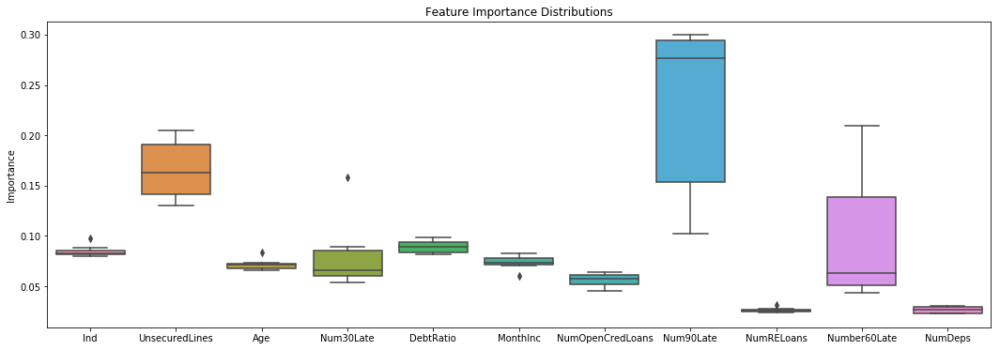

In [13]:
import seaborn as sns
# get the feature importances from each tree and then visualize the
# distributions as boxplots
all_feat_imp_df = pd.DataFrame(data=[tree.feature_importances_ for tree in 
                                     rfc],
                               columns=features)

plt.figure(figsize=(18, 6))
(sns.boxplot(data=all_feat_imp_df)
        .set(title='Feature Importance Distributions',
             ylabel='Importance'));

### USE LIME FOR INSTANCE AND MODEL EXPLANATIONS

In [14]:
#already created array with predicted probabilities
y_pred_proba
len(y_pred_proba)
y_pred_proba[88]
y_pred

array([0, 0, 0, ..., 0, 0, 0])

In [15]:
#already created array with predicted y values (turn into np array)
y_pred = np.array(y_pred)

#create array with actual y values
y_actual = np.array(y_test)
y_actual

array([0, 0, 0, ..., 0, 0, 0])

In [16]:
#load class names for explanations
import sklearn.preprocessing

class_names = ['not dlq', 'yes dlq']
labels = class_names
le= sklearn.preprocessing.LabelEncoder()
le.fit(labels)
labels = le.transform(labels)
class_names = le.classes_
le_label_mapping = dict(zip(le.classes_, le.transform(le.classes_)))

In [17]:
labels
le_label_mapping

{'not dlq': 0, 'yes dlq': 1}

In [18]:
class_names[y_test.values[30]]

'yes dlq'

In [36]:
from sklearn.pipeline import make_pipeline

sklearn.metrics.f1_score(y_actual, y_pred, average='binary')

#create a combined array to hold my 0 and 1 class tuples
dlq_proba = rfc.predict_proba(X_test)[:,1]
notdlq_proba = rfc.predict_proba(X_test)[:,0]
proba_tuples = list(zip(notdlq_proba, dlq_proba))
proba_tuples
#proba_tuples[0][1]


[(0.985884935277997, 0.014115064722002895),
 (0.9529630579618834, 0.04703694203811664),
 (0.8609614143903002, 0.13903858560969987),
 (0.8386178055396528, 0.1613821944603473),
 (0.9895984649868111, 0.01040153501318888),
 (0.9955872488225724, 0.004412751177427641),
 (0.734321369185405, 0.26567863081459503),
 (0.988667250978396, 0.011332749021603862),
 (0.9927678767011886, 0.00723212329881147),
 (0.9903635237139126, 0.00963647628608738),
 (0.9256453533760979, 0.07435464662390208),
 (0.9642802446309557, 0.03571975536904419),
 (0.9870911680751326, 0.012908831924867406),
 (0.995943386732975, 0.004056613267025006),
 (0.9765674547445574, 0.02343254525544283),
 (0.9625054819093151, 0.037494518090685006),
 (0.9896992430785244, 0.010300756921475609),
 (0.9773187036434619, 0.022681296356538268),
 (0.932837490138809, 0.06716250986119089),
 (0.9822786551126826, 0.017721344887317327),
 (0.9556539805071552, 0.04434601949284473),
 (0.9715537856144133, 0.028446214385586893),
 (0.693261175772852, 0.30673

In [20]:
num_features = len(features)
#create LIME explainer object

explainer = LimeTabularExplainer(X_train.values, mode = 'regression',
                                            feature_names = features,
                                            class_names=class_names,
                                            categorical_features = [1],
                                            random_state=random_state,
                                            categorical_names = ['SeriousDlqin2yrs'], 
                                            discretize_continuous = False)

In [21]:
#create my predict function to pass in explainer instance
predict_fn = lambda x: rfc.predict_proba(x)[:,1].astype(float)

Document id: 150
Probability(delinquent) = 0.008867793869048712
True class: not dlq


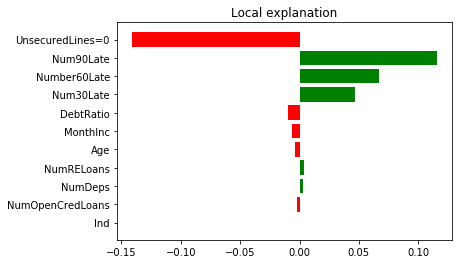

In [46]:
#try out explaining a row
exp_idx = 150
#import imp
#imp.reload(pd)
exp = explainer.explain_instance(X_test.iloc[exp_idx,:].values, predict_fn, num_features=num_features)
print('Document id: %d' % exp_idx)
print('Probability(delinquent) =', proba_tuples[exp_idx][1])
print('True class: %s' % class_names[y_test.values[exp_idx]])
exp.as_pyplot_figure();
exp.show_in_notebook()

Case 150 is a true negative (not delinquent) and unsecured lines, debt ratio, monthly income, age, and number of open credit loands are associated with the label.

In [47]:
exp.local_pred[0]

0.14970369344645065

In [48]:
exp.intercept[0]

0.32083350640774905

In [386]:
#explain random 100 cases
import random

for i in range(0,100):
    x = random.randint(1,len(y_actual))
    exp_idx = x
    exp = explainer.explain_instance(X_test.iloc[exp_idx,:].values, predict_fn, num_features=num_features)
    print('Document id: %d' % exp_idx)
    print('Probability(delinquent) =', proba_tuples[exp_idx][1])
    print('True class: %s' % class_names[y_test.values[exp_idx]])

Document id: 4677
Probability(delinquent) = 0.025613685478395275
True class: not dlq
Document id: 28427
Probability(delinquent) = 0.016677769899185273
True class: not dlq
Document id: 18657
Probability(delinquent) = 0.05427539572625615
True class: not dlq
Document id: 4943
Probability(delinquent) = 0.24459720521622166
True class: yes dlq
Document id: 1604
Probability(delinquent) = 0.01903036980574543
True class: not dlq
Document id: 28199
Probability(delinquent) = 0.10510205901976835
True class: not dlq
Document id: 27807
Probability(delinquent) = 0.07938626537387265
True class: not dlq
Document id: 19170
Probability(delinquent) = 0.013882984953717065
True class: not dlq
Document id: 22236
Probability(delinquent) = 0.013711685681784247
True class: not dlq
Document id: 27258
Probability(delinquent) = 0.09512942593695599
True class: not dlq
Document id: 13199
Probability(delinquent) = 0.8023570632266284
True class: yes dlq
Document id: 11350
Probability(delinquent) = 0.01953948883478767


Running 100 random explainers reveals that we do have some false positives and negatives.

In [22]:
#put misclassified cases into an array
misclassified = np.where(y_actual != y_pred)
misclassified[0]
len(misclassified[0])
misclassified = np.asarray(misclassified[0])
len(misclassified)

1924

There are 1,924 misclassified documents.

0 is NOT Delinquent and 1 is Delinquent

Positive examples Predicted to be Delinquent, actually Delinquent (TP): Document 2688 Document 15846

Predicted to be NOT Delinquent, actually NOT Delinquent (TN): Document 8846 Document 18925

Negative examples: Predicted to be NOT Delinquent, actually Delinquent (FN): Document 2730 Document 17994

Predicted to be Delinquent, actually NOT Delinquent (FP): Document 14494

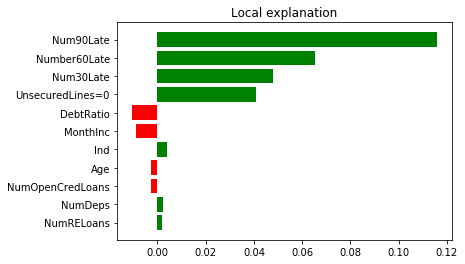

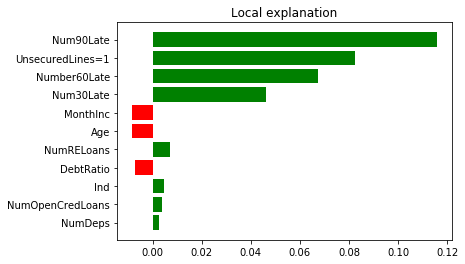

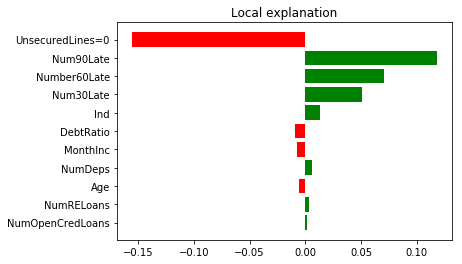

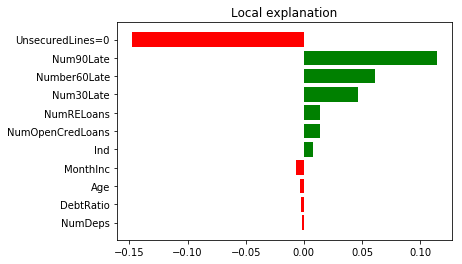

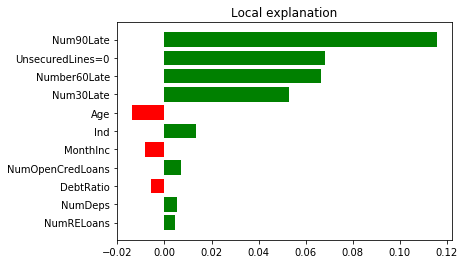

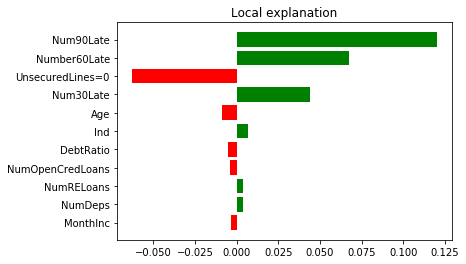

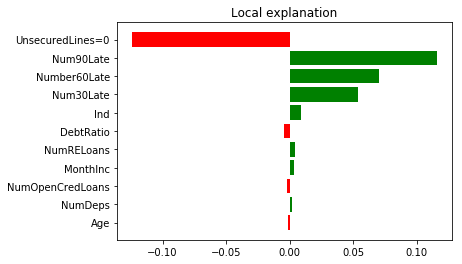

In [23]:
#here are 7 picks that represent TP, FP, TN, and FN
misc_picks = [2688,15846,18925,8846,14494,2730,17994]

%matplotlib inline
    
for i in range(len(misc_picks)):
    exp = explainer.explain_instance(X_test.iloc[misc_picks[i],:].values, predict_fn, num_features=num_features)
    fig = exp.as_pyplot_figure()
    exp.as_list()
    exp.show_in_notebook()


In [24]:
exp.save_to_file('data/misc_exs.html')

In [38]:
#calculate magnitude of error

conf_arr = []

for i in range(len(misclassified)):
    exp = explainer.explain_instance(X_test.iloc[misclassified[i],:].values, predict_fn, num_features=5)
    print('Document id: %d' % misclassified[i])
    #conf = c.predict_proba(X_test.iloc[misclassified[i],:].values)[0]
    #conf_diff = abs(conf[0] - conf[1])
    conf_diff = abs(proba_tuples[misclassified[i]][0] - proba_tuples[misclassified[i]][1])
    conf_arr.append(conf_diff)
    print('True class: %s' % class_names[y_test.values[misclassified[i]]])
    print('Probability difference =', conf_diff)
#create array from values
print (conf_arr)

Document id: 22
True class: yes dlq
Probability difference = 0.3865223515457039
Document id: 25
True class: not dlq
Probability difference = 0.5436144418241606
Document id: 30
True class: yes dlq
Probability difference = 0.553687625342555
Document id: 65
True class: not dlq
Probability difference = 0.6625179926084418
Document id: 70
True class: yes dlq
Probability difference = 0.31578947368421045
Document id: 73
True class: yes dlq
Probability difference = 0.9004333049994558
Document id: 100
True class: yes dlq
Probability difference = 0.09425495998641187
Document id: 116
True class: yes dlq
Probability difference = 0.8752858040648995
Document id: 137
True class: yes dlq
Probability difference = 0.7888295055873659
Document id: 149
True class: yes dlq
Probability difference = 0.9191865692222004
Document id: 169
True class: yes dlq
Probability difference = 0.9777862975127392
Document id: 176
True class: not dlq
Probability difference = 0.20597415208193653
Document id: 199
True class: yes

Document id: 1511
True class: yes dlq
Probability difference = 0.3547857196485921
Document id: 1525
True class: not dlq
Probability difference = 0.06758997219799773
Document id: 1542
True class: yes dlq
Probability difference = 0.967804868147632
Document id: 1547
True class: yes dlq
Probability difference = 0.9076677449036671
Document id: 1566
True class: yes dlq
Probability difference = 0.9760765122506269
Document id: 1574
True class: yes dlq
Probability difference = 0.4056305717103013
Document id: 1576
True class: yes dlq
Probability difference = 0.9751870180674016
Document id: 1593
True class: yes dlq
Probability difference = 0.14365366923618184
Document id: 1617
True class: yes dlq
Probability difference = 0.01785714285714285
Document id: 1624
True class: yes dlq
Probability difference = 0.4796827822037906
Document id: 1675
True class: yes dlq
Probability difference = 0.5955287951625128
Document id: 1676
True class: yes dlq
Probability difference = 0.963561085351224
Document id: 17

Document id: 2993
True class: not dlq
Probability difference = 0.424769514161045
Document id: 3004
True class: yes dlq
Probability difference = 0.4829497663032001
Document id: 3005
True class: yes dlq
Probability difference = 0.15086496729628962
Document id: 3067
True class: yes dlq
Probability difference = 0.222034484731172
Document id: 3075
True class: yes dlq
Probability difference = 0.9775230908734929
Document id: 3076
True class: yes dlq
Probability difference = 0.5636993790564466
Document id: 3078
True class: yes dlq
Probability difference = 0.7202621507020709
Document id: 3080
True class: yes dlq
Probability difference = 0.8446783339691698
Document id: 3081
True class: yes dlq
Probability difference = 0.8170011651493032
Document id: 3135
True class: yes dlq
Probability difference = 0.905320767190095
Document id: 3145
True class: yes dlq
Probability difference = 0.35823693442701265
Document id: 3150
True class: yes dlq
Probability difference = 0.6487122325152038
Document id: 3176

Document id: 4609
True class: not dlq
Probability difference = 0.04200072373446989
Document id: 4664
True class: yes dlq
Probability difference = 0.8170542104558804
Document id: 4683
True class: yes dlq
Probability difference = 0.9751333433714271
Document id: 4689
True class: yes dlq
Probability difference = 0.9171995231200228
Document id: 4695
True class: yes dlq
Probability difference = 0.9163800942918613
Document id: 4720
True class: yes dlq
Probability difference = 0.4359790245392526
Document id: 4727
True class: yes dlq
Probability difference = 0.6196874446446119
Document id: 4730
True class: yes dlq
Probability difference = 0.5432574298553681
Document id: 4736
True class: yes dlq
Probability difference = 0.7453946900499315
Document id: 4750
True class: yes dlq
Probability difference = 0.33152416602613344
Document id: 4755
True class: yes dlq
Probability difference = 0.24184576485461434
Document id: 4758
True class: yes dlq
Probability difference = 0.8584425457941154
Document id: 

Document id: 6111
True class: not dlq
Probability difference = 0.1914686987009302
Document id: 6126
True class: yes dlq
Probability difference = 0.9065703347826507
Document id: 6133
True class: yes dlq
Probability difference = 0.8545999667507181
Document id: 6134
True class: yes dlq
Probability difference = 0.5264713580275713
Document id: 6146
True class: yes dlq
Probability difference = 0.7040718224935343
Document id: 6152
True class: yes dlq
Probability difference = 0.9021069093133799
Document id: 6192
True class: yes dlq
Probability difference = 0.9676598963690632
Document id: 6193
True class: yes dlq
Probability difference = 0.4983908206426644
Document id: 6197
True class: yes dlq
Probability difference = 0.0076823832981468
Document id: 6230
True class: yes dlq
Probability difference = 0.6513750799465085
Document id: 6270
True class: yes dlq
Probability difference = 0.7110644908401802
Document id: 6284
True class: yes dlq
Probability difference = 0.9785818702618053
Document id: 631

Document id: 7835
True class: yes dlq
Probability difference = 0.9737476927397658
Document id: 7855
True class: yes dlq
Probability difference = 0.9428653324384506
Document id: 7862
True class: not dlq
Probability difference = 0.14108140262597985
Document id: 7880
True class: yes dlq
Probability difference = 0.8452715577903918
Document id: 7891
True class: yes dlq
Probability difference = 0.6823361771810836
Document id: 7928
True class: yes dlq
Probability difference = 0.5182083985706921
Document id: 7947
True class: yes dlq
Probability difference = 0.49221382599864977
Document id: 7952
True class: yes dlq
Probability difference = 0.8422958775824875
Document id: 7970
True class: yes dlq
Probability difference = 0.8140243882216605
Document id: 7972
True class: yes dlq
Probability difference = 0.924048733864261
Document id: 7993
True class: yes dlq
Probability difference = 0.11431348118523643
Document id: 8009
True class: yes dlq
Probability difference = 0.7829110779930453
Document id: 8

Document id: 9425
True class: yes dlq
Probability difference = 0.7307514300887163
Document id: 9442
True class: yes dlq
Probability difference = 0.7400422653760403
Document id: 9453
True class: not dlq
Probability difference = 0.04644165358451069
Document id: 9456
True class: yes dlq
Probability difference = 0.7727256892216354
Document id: 9459
True class: yes dlq
Probability difference = 0.8126931301084379
Document id: 9466
True class: yes dlq
Probability difference = 0.529986171560022
Document id: 9481
True class: yes dlq
Probability difference = 0.670601210383819
Document id: 9487
True class: yes dlq
Probability difference = 0.9771423016113265
Document id: 9499
True class: yes dlq
Probability difference = 0.7877935340192583
Document id: 9501
True class: not dlq
Probability difference = 0.18451646155771456
Document id: 9525
True class: not dlq
Probability difference = 0.8256802721088435
Document id: 9527
True class: yes dlq
Probability difference = 0.8888189824486884
Document id: 953

Document id: 10836
True class: yes dlq
Probability difference = 0.8404175683010008
Document id: 10848
True class: not dlq
Probability difference = 0.33424588154630724
Document id: 10858
True class: yes dlq
Probability difference = 0.01360410686995378
Document id: 10883
True class: yes dlq
Probability difference = 0.770799468212535
Document id: 10891
True class: yes dlq
Probability difference = 0.8295435348345301
Document id: 10893
True class: yes dlq
Probability difference = 0.4889494241740642
Document id: 10903
True class: yes dlq
Probability difference = 0.5728616036578565
Document id: 10908
True class: yes dlq
Probability difference = 0.8095593893580417
Document id: 10909
True class: yes dlq
Probability difference = 0.06116865350791478
Document id: 10926
True class: yes dlq
Probability difference = 0.21200796107916836
Document id: 10943
True class: yes dlq
Probability difference = 0.6847976339281381
Document id: 10950
True class: yes dlq
Probability difference = 0.05021719531185975


Document id: 12149
True class: yes dlq
Probability difference = 0.6780746653275879
Document id: 12215
True class: yes dlq
Probability difference = 0.41284303194962196
Document id: 12227
True class: yes dlq
Probability difference = 0.12978767264481544
Document id: 12251
True class: yes dlq
Probability difference = 0.9224608466674399
Document id: 12262
True class: yes dlq
Probability difference = 0.8980922293626031
Document id: 12266
True class: yes dlq
Probability difference = 0.271794804387687
Document id: 12274
True class: yes dlq
Probability difference = 0.2817655431616759
Document id: 12319
True class: yes dlq
Probability difference = 0.8170985728866307
Document id: 12354
True class: yes dlq
Probability difference = 0.7821808994868091
Document id: 12362
True class: yes dlq
Probability difference = 0.6485201337589939
Document id: 12363
True class: yes dlq
Probability difference = 0.4689326391060586
Document id: 12377
True class: yes dlq
Probability difference = 0.779009959168267
Docu

Document id: 13723
True class: yes dlq
Probability difference = 0.9319727891156462
Document id: 13727
True class: yes dlq
Probability difference = 0.9842894001806088
Document id: 13728
True class: yes dlq
Probability difference = 0.9840400865810115
Document id: 13748
True class: yes dlq
Probability difference = 0.9616591134273441
Document id: 13777
True class: yes dlq
Probability difference = 0.9686314432787277
Document id: 13818
True class: yes dlq
Probability difference = 0.7692097017712848
Document id: 13846
True class: yes dlq
Probability difference = 0.9234572186571657
Document id: 13849
True class: yes dlq
Probability difference = 0.779289304005822
Document id: 13864
True class: yes dlq
Probability difference = 0.716778330763258
Document id: 13872
True class: yes dlq
Probability difference = 0.7903756183560071
Document id: 13888
True class: yes dlq
Probability difference = 0.36964595177114873
Document id: 13889
True class: yes dlq
Probability difference = 0.7816998517388186
Docum

Document id: 15356
True class: not dlq
Probability difference = 0.06347802430374877
Document id: 15366
True class: yes dlq
Probability difference = 0.8574022733730857
Document id: 15382
True class: not dlq
Probability difference = 0.08672152369431685
Document id: 15416
True class: yes dlq
Probability difference = 0.8406132175296207
Document id: 15430
True class: yes dlq
Probability difference = 0.17223221286299
Document id: 15434
True class: not dlq
Probability difference = 0.3029317743913121
Document id: 15484
True class: yes dlq
Probability difference = 0.9752528826252062
Document id: 15486
True class: yes dlq
Probability difference = 0.7726121126806191
Document id: 15492
True class: yes dlq
Probability difference = 0.6000856614621287
Document id: 15525
True class: yes dlq
Probability difference = 0.899959093930562
Document id: 15529
True class: yes dlq
Probability difference = 0.21980855591326326
Document id: 15542
True class: yes dlq
Probability difference = 0.06729305583619588
Doc

Document id: 16717
True class: yes dlq
Probability difference = 0.2535714285714286
Document id: 16725
True class: yes dlq
Probability difference = 0.9097908743194449
Document id: 16744
True class: yes dlq
Probability difference = 0.9156081180151376
Document id: 16759
True class: yes dlq
Probability difference = 0.9074714879797434
Document id: 16760
True class: yes dlq
Probability difference = 0.14441707956258654
Document id: 16765
True class: yes dlq
Probability difference = 0.7985903154009979
Document id: 16771
True class: yes dlq
Probability difference = 0.389597662558355
Document id: 16806
True class: yes dlq
Probability difference = 0.9260017648049244
Document id: 16823
True class: yes dlq
Probability difference = 0.1293784931942163
Document id: 16843
True class: yes dlq
Probability difference = 0.9829937933512622
Document id: 16856
True class: yes dlq
Probability difference = 0.39710144927536234
Document id: 16862
True class: yes dlq
Probability difference = 0.6088020045978771
Doc

Document id: 18434
True class: yes dlq
Probability difference = 0.8428679040321055
Document id: 18435
True class: yes dlq
Probability difference = 0.17668071968123733
Document id: 18443
True class: not dlq
Probability difference = 0.11768970327206674
Document id: 18444
True class: yes dlq
Probability difference = 0.9008562327641486
Document id: 18552
True class: yes dlq
Probability difference = 0.553696076163303
Document id: 18563
True class: not dlq
Probability difference = 0.45688576433918043
Document id: 18580
True class: yes dlq
Probability difference = 0.9033113143021458
Document id: 18606
True class: not dlq
Probability difference = 0.10591684434968013
Document id: 18615
True class: yes dlq
Probability difference = 0.9710825398053161
Document id: 18634
True class: yes dlq
Probability difference = 0.17949746057203947
Document id: 18655
True class: yes dlq
Probability difference = 0.8620004467583808
Document id: 18663
True class: yes dlq
Probability difference = 0.8795640658816013


Document id: 20214
True class: yes dlq
Probability difference = 0.739334289280573
Document id: 20263
True class: not dlq
Probability difference = 0.258442887435274
Document id: 20271
True class: yes dlq
Probability difference = 0.010111540159044807
Document id: 20292
True class: yes dlq
Probability difference = 0.5519610289324766
Document id: 20320
True class: yes dlq
Probability difference = 0.3411654135338346
Document id: 20321
True class: yes dlq
Probability difference = 0.9490560450345286
Document id: 20329
True class: yes dlq
Probability difference = 0.8312270314445807
Document id: 20357
True class: yes dlq
Probability difference = 0.7855290357837131
Document id: 20362
True class: yes dlq
Probability difference = 0.9063088117258589
Document id: 20382
True class: yes dlq
Probability difference = 0.8712642293227535
Document id: 20389
True class: yes dlq
Probability difference = 0.026077193823141442
Document id: 20390
True class: yes dlq
Probability difference = 0.37357578169245875
D

Document id: 21695
True class: yes dlq
Probability difference = 0.01663128652671858
Document id: 21697
True class: yes dlq
Probability difference = 0.9513178710131656
Document id: 21725
True class: yes dlq
Probability difference = 0.8749096386876178
Document id: 21734
True class: yes dlq
Probability difference = 0.6406453631593517
Document id: 21738
True class: yes dlq
Probability difference = 0.17314018887091776
Document id: 21741
True class: not dlq
Probability difference = 0.26485647137821056
Document id: 21746
True class: yes dlq
Probability difference = 0.049426017996825555
Document id: 21754
True class: yes dlq
Probability difference = 0.7165581662515252
Document id: 21799
True class: yes dlq
Probability difference = 0.09480519480519484
Document id: 21816
True class: yes dlq
Probability difference = 0.601269937671973
Document id: 21819
True class: yes dlq
Probability difference = 0.12857142857142861
Document id: 21832
True class: not dlq
Probability difference = 0.138035714285714

Document id: 23332
True class: not dlq
Probability difference = 0.1850406792428207
Document id: 23333
True class: yes dlq
Probability difference = 0.8770150751865958
Document id: 23349
True class: yes dlq
Probability difference = 0.9869951997667397
Document id: 23381
True class: not dlq
Probability difference = 0.14285714285714285
Document id: 23399
True class: yes dlq
Probability difference = 0.44663022070645525
Document id: 23402
True class: yes dlq
Probability difference = 0.8647014197630585
Document id: 23421
True class: yes dlq
Probability difference = 0.49185463659147866
Document id: 23424
True class: yes dlq
Probability difference = 0.9683982417433349
Document id: 23432
True class: yes dlq
Probability difference = 0.2076331231793418
Document id: 23443
True class: yes dlq
Probability difference = 0.17075871755395305
Document id: 23457
True class: yes dlq
Probability difference = 0.6165367164442094
Document id: 23462
True class: yes dlq
Probability difference = 0.37230404304873005

Document id: 24808
True class: yes dlq
Probability difference = 0.6471888490144069
Document id: 24813
True class: yes dlq
Probability difference = 0.4251542045114343
Document id: 24822
True class: yes dlq
Probability difference = 0.7333160000519772
Document id: 24823
True class: yes dlq
Probability difference = 0.4147465437788018
Document id: 24829
True class: yes dlq
Probability difference = 0.8538466289089608
Document id: 24836
True class: yes dlq
Probability difference = 0.9796415140228516
Document id: 24837
True class: yes dlq
Probability difference = 0.6852414179322059
Document id: 24853
True class: yes dlq
Probability difference = 0.1355026954114174
Document id: 24860
True class: yes dlq
Probability difference = 0.7754086580227715
Document id: 24889
True class: yes dlq
Probability difference = 0.11428391738298899
Document id: 24893
True class: not dlq
Probability difference = 0.2881773399014779
Document id: 24918
True class: not dlq
Probability difference = 0.3140748446067441
Doc

Document id: 26153
True class: yes dlq
Probability difference = 0.6138926726223424
Document id: 26171
True class: yes dlq
Probability difference = 0.7921126095022681
Document id: 26193
True class: yes dlq
Probability difference = 0.9660356054808522
Document id: 26195
True class: yes dlq
Probability difference = 0.7668011520551397
Document id: 26205
True class: yes dlq
Probability difference = 0.6788121044810715
Document id: 26212
True class: yes dlq
Probability difference = 0.7296985665613502
Document id: 26213
True class: not dlq
Probability difference = 0.025166960003511096
Document id: 26218
True class: yes dlq
Probability difference = 0.8519503085110586
Document id: 26222
True class: yes dlq
Probability difference = 0.1506459563599305
Document id: 26232
True class: yes dlq
Probability difference = 0.9156105541028616
Document id: 26243
True class: yes dlq
Probability difference = 0.7561747054682696
Document id: 26252
True class: yes dlq
Probability difference = 0.9757753145929624
Do

Document id: 27624
True class: yes dlq
Probability difference = 0.49647169212512593
Document id: 27626
True class: yes dlq
Probability difference = 0.9377707664448469
Document id: 27651
True class: yes dlq
Probability difference = 0.9903598979263021
Document id: 27654
True class: yes dlq
Probability difference = 0.8614828242505929
Document id: 27680
True class: yes dlq
Probability difference = 0.8130232118708653
Document id: 27689
True class: yes dlq
Probability difference = 0.960075078945784
Document id: 27699
True class: not dlq
Probability difference = 0.42370414131069206
Document id: 27711
True class: not dlq
Probability difference = 0.10838321099190651
Document id: 27720
True class: yes dlq
Probability difference = 0.6767504126463756
Document id: 27726
True class: yes dlq
Probability difference = 0.4997779139372552
Document id: 27731
True class: not dlq
Probability difference = 0.2144459279038719
Document id: 27739
True class: yes dlq
Probability difference = 0.9505874660595218
Do

Document id: 28947
True class: yes dlq
Probability difference = 0.9678853325151437
Document id: 28974
True class: yes dlq
Probability difference = 0.940058615576943
Document id: 28977
True class: yes dlq
Probability difference = 0.092582969860034
Document id: 28981
True class: yes dlq
Probability difference = 0.8302090398137659
Document id: 29010
True class: yes dlq
Probability difference = 0.19591836734693885
Document id: 29012
True class: yes dlq
Probability difference = 0.8254653794035107
Document id: 29026
True class: yes dlq
Probability difference = 0.9923010842501075
Document id: 29034
True class: yes dlq
Probability difference = 0.5937753831559599
Document id: 29039
True class: yes dlq
Probability difference = 0.9249148539682479
Document id: 29045
True class: yes dlq
Probability difference = 0.8747803197661361
Document id: 29050
True class: not dlq
Probability difference = 0.09610309641097814
Document id: 29070
True class: yes dlq
Probability difference = 0.9807127797997931
Docu

In [39]:
#plot

mag_error = pd.DataFrame(conf_arr)
mag_error.columns = ['dist_error']
mag_error

misclassified_df = pd.DataFrame(misclassified)
misclassified_df.columns = ['doc_id']
misclassified_df

misclassified_df['dist_error'] = mag_error['dist_error']
misclassified_df

,doc_id,dist_error
0,22,0.386522
1,25,0.543614
2,30,0.553688
3,65,0.662518
4,70,0.315789
5,73,0.900433
6,100,0.094255
7,116,0.875286
8,137,0.788830
9,149,0.919187


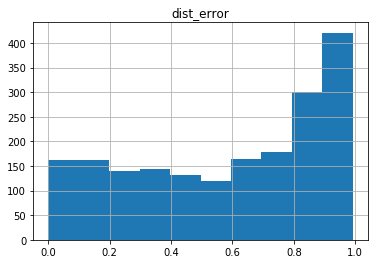

In [40]:
error_distribution = misclassified_df.hist('dist_error',bins=10)

In [50]:
#select representative cases
import warnings
from lime import submodular_pick

In [51]:
sp_obj = submodular_pick.SubmodularPick(explainer, X_train.values, predict_fn, sample_size=10, num_features=num_features, num_exps_desired=10)
#sp_obj.V

In [52]:
for idx in sp_obj.V:
    exp = explainer.explain_instance(X_test.values[idx], predict_fn, num_features=5)
    print("Actual class: ", y_test.iloc[idx])
    exp.show_in_notebook(show_all=False)
    #exp.as_list()

Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


In [53]:
sub_pick_df=pd.DataFrame([dict(this.as_list()) for this in sp_obj.explanations])
sub_pick_df.head()

,Age,DebtRatio,Ind,MonthInc,Num30Late,Num90Late,NumDeps,NumOpenCredLoans,NumRELoans,Number60Late,UnsecuredLines=0
0,-0.007502,-0.007873,-0.000817,-0.009664,0.047904,0.114167,0.005235,0.002907,0.013434,0.067671,-0.139093
1,-0.004978,-0.009629,0.009262,-0.005883,0.049844,0.114635,0.006071,0.000325,0.002489,0.072565,-0.145471
2,-0.006319,-0.001794,0.005347,-0.003079,0.045261,0.114689,0.000946,0.009515,0.011147,0.061440,-0.143905
3,-0.014241,-0.006705,0.013009,-0.007492,0.051834,0.116127,0.006049,0.004842,0.004108,0.068283,-0.125896
4,-0.009314,-0.003871,0.004750,-0.002122,0.044359,0.119130,0.004549,0.000904,0.005531,0.069911,-0.141530
